# analyze casp14 mqa result

In [1]:
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import seaborn as sns
pd.options.display.float_format = '{:.3f}'.format
plt.rcParams["figure.dpi"] = 150
sns.set(style='darkgrid')
from sklearn.metrics import mean_absolute_error, mean_squared_error
from IPython.display import display

In [2]:
# function for performance evaluation 
def get_loss(target_df, label_name, column_name):
    try:
        loss = target_df[label_name].max() - target_df[label_name][target_df[column_name].idxmax()]
    except TypeError as e:
        loss = None
    return loss

def get_whole_loss(df, label_name: str, column_list: list):
    loss_list = [get_loss(df, label_name, column) for column in column_list]
    return pd.DataFrame({label_name + ' Loss':loss_list}, index=column_list)

def get_mae(df, label_name, column_name):
    df = df.dropna(subset=[column_name])
    try:
        mae = mean_absolute_error(df[label_name], df[column_name])
    except ValueError as e:
        mae = None
    return mae

def get_whole_mae(df, label_name: str, column_list: list):
    mae_list = [get_mae(df, label_name, column) for column in column_list]
    return pd.DataFrame({label_name + ' MAE':mae_list}, index=column_list)

def get_mse(df, label_name, column_name):
    df = df.dropna(subset=[column_name])
    try:
        mse = mean_squared_error(df[label_name], df[column_name])
    except ValueError as e:
        mse = None
    return mse

def get_whole_mse(df, label_name: str, column_list: list):
    mse_list = [get_mse(df, label_name, column) for column in column_list]
    return pd.DataFrame({label_name + ' MSE':mse_list}, index=column_list)

def eval(df, columns, label_name='GDT_TS', threshold=0):
    metrics_array = []
    df = df.groupby('Target').filter(lambda x: x[label_name].max() >= threshold)
    if df[label_name].max() > 1:
        df[label_name] /= 100
    group = df.groupby('Target')
    pearson = group.corr()[label_name].loc[:, columns].rename(label_name + ' Pearson')
    spearman = group.corr(method='spearman')[label_name].loc[:, columns].rename(label_name + ' Spearman')
    loss = group.apply(lambda x: get_whole_loss(x, label_name, columns)) * 100
    mae = group.apply(lambda x: get_whole_mae(x, label_name, columns))
    mse = group.apply(lambda x: get_whole_mse(x, label_name, columns))
    performance_df = pd.concat([pearson, spearman, loss, mae, mse], axis=1).reset_index().rename(columns={'level_1': 'Group'})
    print(len(group))
    return performance_df

In [3]:
# function for visualization
def scatter(df, x='GDT_TS', y='Proposed', col_wrap=4):
    g = sns.relplot(data=df, kind='scatter', x=x, y=y, col='Target', col_wrap=col_wrap)
    g.set(xlim=(0, 100), ylim=(0, 1))
    plt.subplots_adjust(wspace=0.1)

## read mqa score

In [4]:
df = pd.read_csv('../download/data/casp14_stage2.csv', index_col=0)
df = df.dropna(subset=['GDT_TS'])

In [5]:
# filter targets not included in the mqa results table (T1027, T1088) and not define domain classification (T1048, T1062, T1072s1, T1098)
fil_target = ['T1027', 'T1088'] + ['T1048', 'T1062', 'T1072s1', 'T1098']
df_fil = df.groupby('Target').filter(lambda x: x.name not in fil_target)

In [6]:
df_fil

,3DCNN_prof,ProQ3D,GraphQA,angleQA,ProQ2,DAVIS-EMAconsensus,BAKER-ROSETTASERVER,BAKER-experimental,P3De,ModFOLD8,...,MolPrb_ramfv,N1,N2,DIST,N,RMSD,GDT_TS,LGA_S3,LGA_Q,Target
T1024TS075_1,0.661,0.586,0.649,0.467,0.598,0.648,0.678,0.618,0.568,0.582,...,95.320,408.000,391.000,4.000,203.000,2.480,47.059,45.012,7.868,T1024
T1024TS050_4,0.570,0.541,0.579,0.416,0.547,0.624,0.601,0.542,0.532,0.571,...,93.100,408.000,391.000,4.000,224.000,2.690,50.256,48.095,8.024,T1024
T1024TS211_4,0.560,0.532,0.584,0.419,0.541,0.611,0.625,0.592,0.492,0.536,...,84.680,374.000,391.000,4.000,199.000,2.320,46.036,46.466,8.220,T1024
T1024TS367_5,0.698,0.684,0.646,0.601,0.610,0.690,0.743,0.731,0.614,0.579,...,96.800,408.000,391.000,4.000,328.000,2.330,60.934,62.641,13.478,T1024
T1024TS278_1,0.697,0.751,0.716,0.487,0.738,0.683,0.727,0.668,0.703,0.557,...,97.540,408.000,391.000,4.000,289.000,2.260,59.910,55.603,12.245,T1024
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
T1101TS013_5,0.677,0.653,0.719,0.708,0.791,0.518,0.739,0.762,0.625,0.528,...,94.300,318.000,297.000,4.000,172.000,1.940,47.138,43.689,8.418,T1101
T1101TS031_4,0.711,0.603,0.668,0.693,0.666,0.559,0.679,0.661,0.594,0.537,...,90.190,318.000,297.000,4.000,188.000,1.880,51.010,48.073,9.512,T1101
T1101TS140_5,0.690,0.624,0.704,0.762,0.676,0.574,0.701,0.731,0.590,0.563,...,91.140,318.000,297.000,4.000,200.000,2.560,57.239,50.569,7.505,T1101
T1101TS435_4,0.669,0.533,0.666,0.692,0.691,0.546,0.629,0.604,0.549,0.507,...,79.430,318.000,297.000,4.000,168.000,2.400,49.579,43.283,6.709,T1101


## read domain definitions and classifications

In [7]:
dom_cla_df = pd.read_csv('../download/data/casp14_domain_definitions_and_classifications_fixed.csv', index_col=0)
# delete duplicated target (multidomain)
dom_cla_df = dom_cla_df.drop_duplicates(keep='first', subset='Target')
dom_cla_df

,Target,Residues,Type,Domains,Residues in domain,Classification,PDB,Domain
#,,,,,,,,
1,T1024,408,All groups,T1024-D0,408,TBM-easy,6t1z,MultiDomain
3,T1025,268,Server only,T1025-D1: 12-268,257,TBM-easy,6uv6,SingleDomain
4,T1026,172,All groups,T1026-D1: 27-172,146,TBM-hard,6s44,SingleDomain
5,T1027,168,All groups,"T1027-D1: 8-18,34-81,95-134",99,FM,-,SingleDomain
6,T1028,316,Server only,T1028-D1: 16-307,292,TBM-easy,-,SingleDomain
...,...,...,...,...,...,...,...,...
99,T1095,665,All groups,T1095-D1: 1-649,649,TBM-hard,-,SingleDomain
100,T1096,464,All groups,T1096-D0,464,FM,-,MultiDomain
102,T1099,262,All groups,T1099-D1: 11-188,178,TBM-hard,6ygh,SingleDomain


## concat mqa df and domain df

In [8]:
cdf = pd.merge(df_fil, dom_cla_df, on='Target', how='inner')
cdf

,3DCNN_prof,ProQ3D,GraphQA,angleQA,ProQ2,DAVIS-EMAconsensus,BAKER-ROSETTASERVER,BAKER-experimental,P3De,ModFOLD8,...,LGA_S3,LGA_Q,Target,Residues,Type,Domains,Residues in domain,Classification,PDB,Domain
0,0.661,0.586,0.649,0.467,0.598,0.648,0.678,0.618,0.568,0.582,...,45.012,7.868,T1024,408,All groups,T1024-D0,408,TBM-easy,6t1z,MultiDomain
1,0.570,0.541,0.579,0.416,0.547,0.624,0.601,0.542,0.532,0.571,...,48.095,8.024,T1024,408,All groups,T1024-D0,408,TBM-easy,6t1z,MultiDomain
2,0.560,0.532,0.584,0.419,0.541,0.611,0.625,0.592,0.492,0.536,...,46.466,8.220,T1024,408,All groups,T1024-D0,408,TBM-easy,6t1z,MultiDomain
3,0.698,0.684,0.646,0.601,0.610,0.690,0.743,0.731,0.614,0.579,...,62.641,13.478,T1024,408,All groups,T1024-D0,408,TBM-easy,6t1z,MultiDomain
4,0.697,0.751,0.716,0.487,0.738,0.683,0.727,0.668,0.703,0.557,...,55.603,12.245,T1024,408,All groups,T1024-D0,408,TBM-easy,6t1z,MultiDomain
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9889,0.677,0.653,0.719,0.708,0.791,0.518,0.739,0.762,0.625,0.528,...,43.689,8.418,T1101,318,All groups,T1101-D0: 12-318,307,TBM-easy,-,MultiDomain
9890,0.711,0.603,0.668,0.693,0.666,0.559,0.679,0.661,0.594,0.537,...,48.073,9.512,T1101,318,All groups,T1101-D0: 12-318,307,TBM-easy,-,MultiDomain
9891,0.690,0.624,0.704,0.762,0.676,0.574,0.701,0.731,0.590,0.563,...,50.569,7.505,T1101,318,All groups,T1101-D0: 12-318,307,TBM-easy,-,MultiDomain
9892,0.669,0.533,0.666,0.692,0.691,0.546,0.629,0.604,0.549,0.507,...,43.283,6.709,T1101,318,All groups,T1101-D0: 12-318,307,TBM-easy,-,MultiDomain


## performance evaluation

In [9]:
df.columns

Index(['3DCNN_prof', 'ProQ3D', 'GraphQA', 'angleQA', 'ProQ2',
       'DAVIS-EMAconsensus', 'BAKER-ROSETTASERVER', 'BAKER-experimental',
       'P3De', 'ModFOLD8', 'tFold-IDT', 'VoroCNN-GDT', 'VoroCNN-GEMME',
       'DeepPotential', 'Ornate', 'SBROD', 'GR#', 'NP_P', 'RANK', 'Z-M1-GDT',
       'Z-MA-GDT', 'GDT_HA', 'GDC_SC', 'GDC_ALL', 'RMS_CA', 'RMS_ALL', 'NP',
       'err', 'AL0_P', 'AL4_P', 'ALI_P', 'LGA_S', 'RMSD[L]', 'Z-score[M]',
       'Z-Score[D]', 'Al.Res.', 'RMSD[D]', 'MolPrb_Score', 'LDDT', 'SphGr',
       'CAD_AA', 'RPF', 'CODM', 'DFM', 'Handed.', 'SOV', 'CE', 'QCS', 'CONTS',
       'TMscore', 'Dali(raw)', 'FlexE', 'QSE', 'CAD_SS', 'MolPrb_clash',
       'MolPrb_rotout', 'MolPrb_ramout', 'MolPrb_ramfv', 'N1', 'N2', 'DIST',
       'N', 'RMSD', 'GDT_TS', 'LGA_S3', 'LGA_Q', 'Target'],
      dtype='object')

In [10]:
single_model_list = ['3DCNN_prof', 'ProQ3D', 'GraphQA', 'angleQA', 'ProQ2',
       'DAVIS-EMAconsensus', 'BAKER-ROSETTASERVER', 'BAKER-experimental',
       'P3De', 'ModFOLD8', 'tFold-IDT', 'VoroCNN-GDT', 'VoroCNN-GEMME',
       'DeepPotential', 'Ornate', 'SBROD', 'LDDT']

In [11]:
eval_df = eval(df_fil, columns=single_model_list, threshold=40)
eval_df.groupby('Group').mean().reset_index()

58


,Group,GDT_TS Pearson,GDT_TS Spearman,GDT_TS Loss,GDT_TS MAE,GDT_TS MSE
0,3DCNN_prof,0.598,0.560,10.480,0.149,0.034
1,BAKER-ROSETTASERVER,0.662,0.613,8.332,0.117,0.023
2,BAKER-experimental,0.623,0.589,8.378,0.121,0.025
3,DAVIS-EMAconsensus,0.764,0.696,9.103,0.070,0.011
4,DeepPotential,0.590,0.498,11.849,0.117,0.027
5,GraphQA,0.521,0.482,9.815,0.135,0.030
6,LDDT,0.780,0.784,2.121,0.099,0.014
7,ModFOLD8,0.649,0.602,8.496,0.140,0.032
8,Ornate,0.550,0.515,12.236,0.158,0.036
9,P3De,0.560,0.516,10.645,0.120,0.023


In [12]:
eval_df.groupby('Group').mean().sort_values('GDT_TS Loss')

,GDT_TS Pearson,GDT_TS Spearman,GDT_TS Loss,GDT_TS MAE,GDT_TS MSE
Group,,,,,
LDDT,0.780,0.784,2.121,0.099,0.014
BAKER-ROSETTASERVER,0.662,0.613,8.332,0.117,0.023
BAKER-experimental,0.623,0.589,8.378,0.121,0.025
ModFOLD8,0.649,0.602,8.496,0.140,0.032
DAVIS-EMAconsensus,0.764,0.696,9.103,0.070,0.011
VoroCNN-GDT,0.557,0.508,9.707,0.157,0.034
GraphQA,0.521,0.482,9.815,0.135,0.030
3DCNN_prof,0.598,0.560,10.480,0.149,0.034
VoroCNN-GEMME,0.537,0.488,10.560,0.150,0.032


In [13]:
eval_df

,Target,Group,GDT_TS Pearson,GDT_TS Spearman,GDT_TS Loss,GDT_TS MAE,GDT_TS MSE
0,T1024,3DCNN_prof,0.631,0.628,3.645,0.090,0.010
1,T1024,ProQ3D,0.753,0.648,3.772,0.087,0.010
2,T1024,GraphQA,0.738,0.573,4.412,0.120,0.016
3,T1024,angleQA,0.738,0.738,5.115,0.071,0.007
4,T1024,ProQ2,0.660,0.597,3.772,0.082,0.009
...,...,...,...,...,...,...,...
981,T1101,VoroCNN-GEMME,0.322,0.356,1.179,0.088,0.010
982,T1101,DeepPotential,0.132,0.102,10.691,0.194,0.041
983,T1101,Ornate,0.235,0.249,1.179,0.047,0.003
984,T1101,SBROD,0.291,0.301,3.452,0.203,0.047


In [14]:
ceval_df = pd.merge(eval_df, dom_cla_df, on='Target', how='inner')

In [15]:
ceval_df

,Target,Group,GDT_TS Pearson,GDT_TS Spearman,GDT_TS Loss,GDT_TS MAE,GDT_TS MSE,Residues,Type,Domains,Residues in domain,Classification,PDB,Domain
0,T1024,3DCNN_prof,0.631,0.628,3.645,0.090,0.010,408,All groups,T1024-D0,408,TBM-easy,6t1z,MultiDomain
1,T1024,ProQ3D,0.753,0.648,3.772,0.087,0.010,408,All groups,T1024-D0,408,TBM-easy,6t1z,MultiDomain
2,T1024,GraphQA,0.738,0.573,4.412,0.120,0.016,408,All groups,T1024-D0,408,TBM-easy,6t1z,MultiDomain
3,T1024,angleQA,0.738,0.738,5.115,0.071,0.007,408,All groups,T1024-D0,408,TBM-easy,6t1z,MultiDomain
4,T1024,ProQ2,0.660,0.597,3.772,0.082,0.009,408,All groups,T1024-D0,408,TBM-easy,6t1z,MultiDomain
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
981,T1101,VoroCNN-GEMME,0.322,0.356,1.179,0.088,0.010,318,All groups,T1101-D0: 12-318,307,TBM-easy,-,MultiDomain
982,T1101,DeepPotential,0.132,0.102,10.691,0.194,0.041,318,All groups,T1101-D0: 12-318,307,TBM-easy,-,MultiDomain
983,T1101,Ornate,0.235,0.249,1.179,0.047,0.003,318,All groups,T1101-D0: 12-318,307,TBM-easy,-,MultiDomain
984,T1101,SBROD,0.291,0.301,3.452,0.203,0.047,318,All groups,T1101-D0: 12-318,307,TBM-easy,-,MultiDomain


In [16]:
# boxplot and swarmplot for each group
def plot_metrics_group(df, metrics, hue=None, figsize=(10, 8), pointsize=4):
    plt.figure(figsize=figsize)
    sns.boxplot(data=df, x=metrics, y='Group', orient='h', color='white')
    sns.swarmplot(data=df, x=metrics, y='Group', orient='h', hue=hue, size=pointsize, palette='Set2')
    plt.tight_layout()

### GDT_TS loss for each group

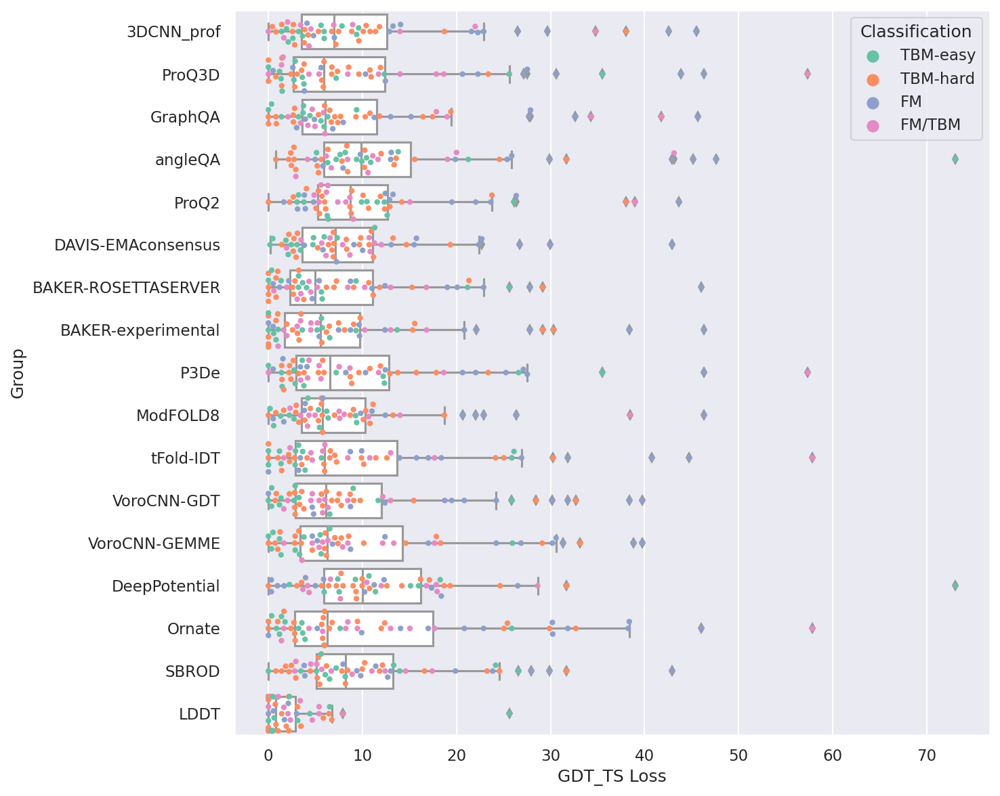

In [17]:
metrics = 'GDT_TS Loss'
hue = 'Classification'
plot_metrics_group(ceval_df, metrics, hue)
plt.savefig('../download/data/plot/casp14_gdtts_loss_boxplot_class.png')

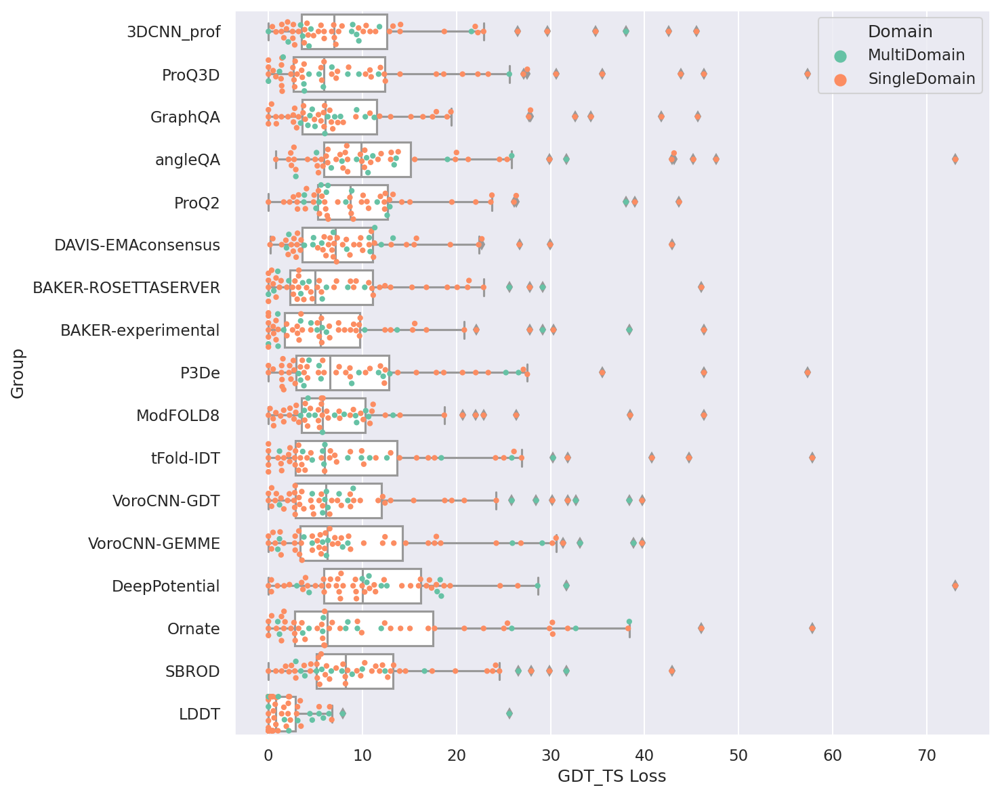

In [18]:
metrics = 'GDT_TS Loss'
hue = 'Domain'
plot_metrics_group(ceval_df, metrics=metrics, hue=hue)
plt.savefig('../download/data/plot/casp14_gdtts_loss_boxplot_domain.png')

### Pearson for each group

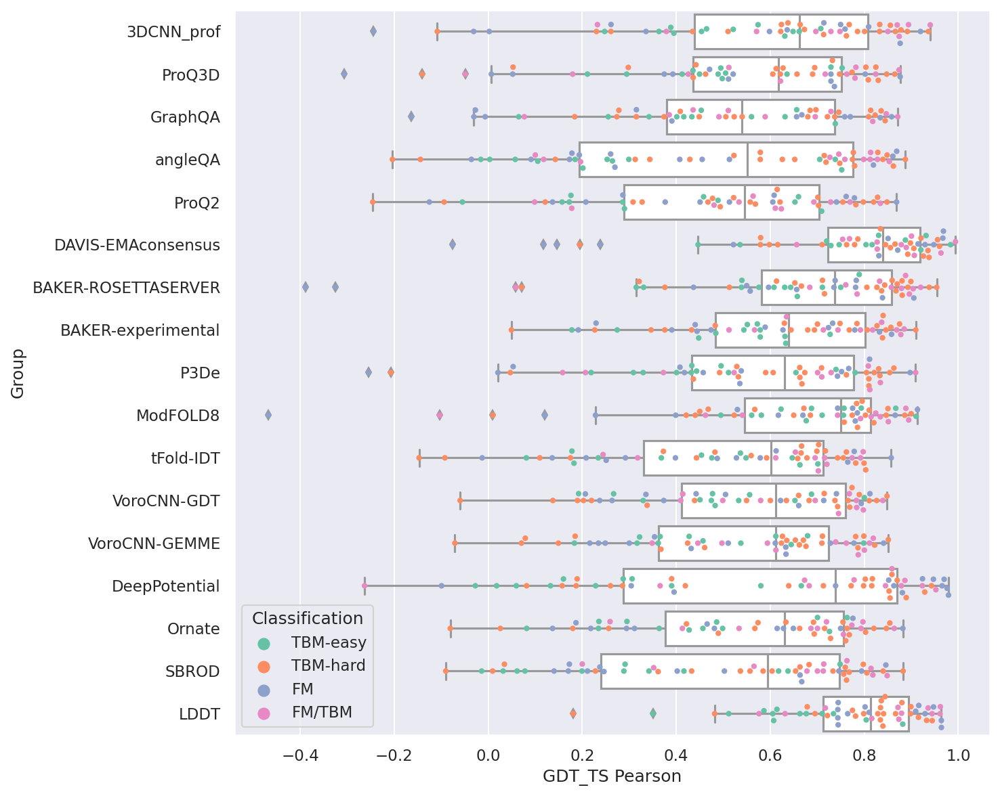

In [19]:
metrics = 'GDT_TS Pearson'
hue = 'Classification'
plot_metrics_group(ceval_df, metrics, hue)
plt.savefig('../download/data/plot/casp14_gdtts_pearson_boxplot_class.png')

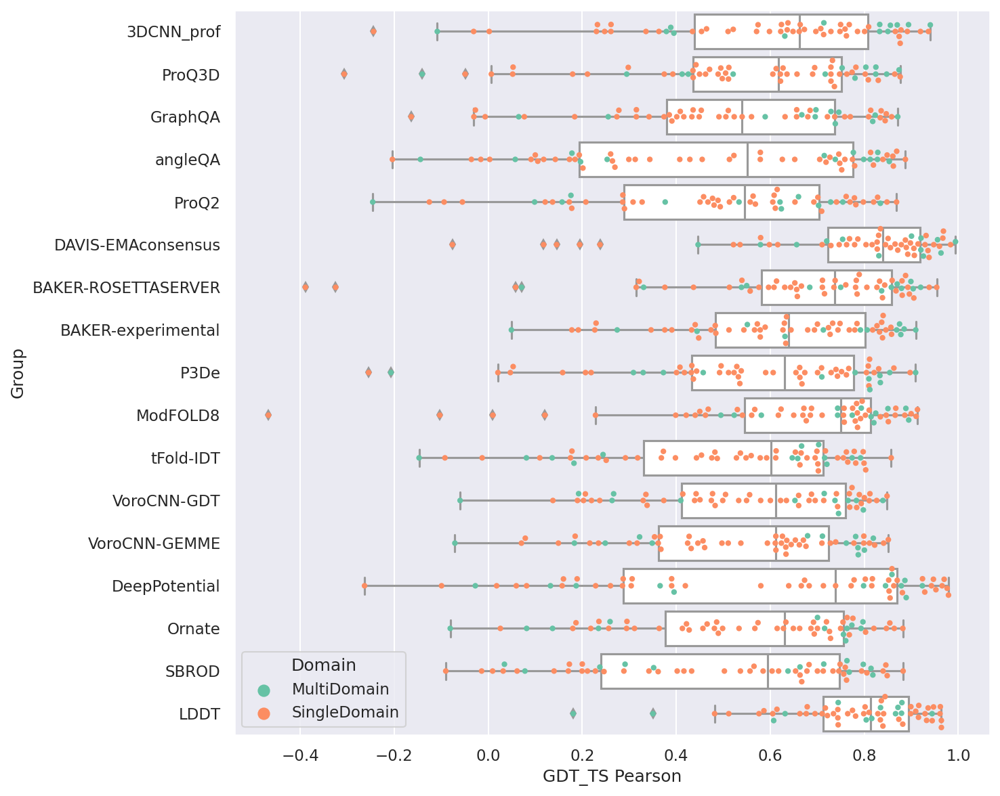

In [20]:
metrics = 'GDT_TS Pearson'
hue = 'Domain'
plot_metrics_group(ceval_df, metrics, hue)
plt.savefig('../download/data/plot/casp14_gdtts_pearson_boxplot_domain.png')

### MAE for each group

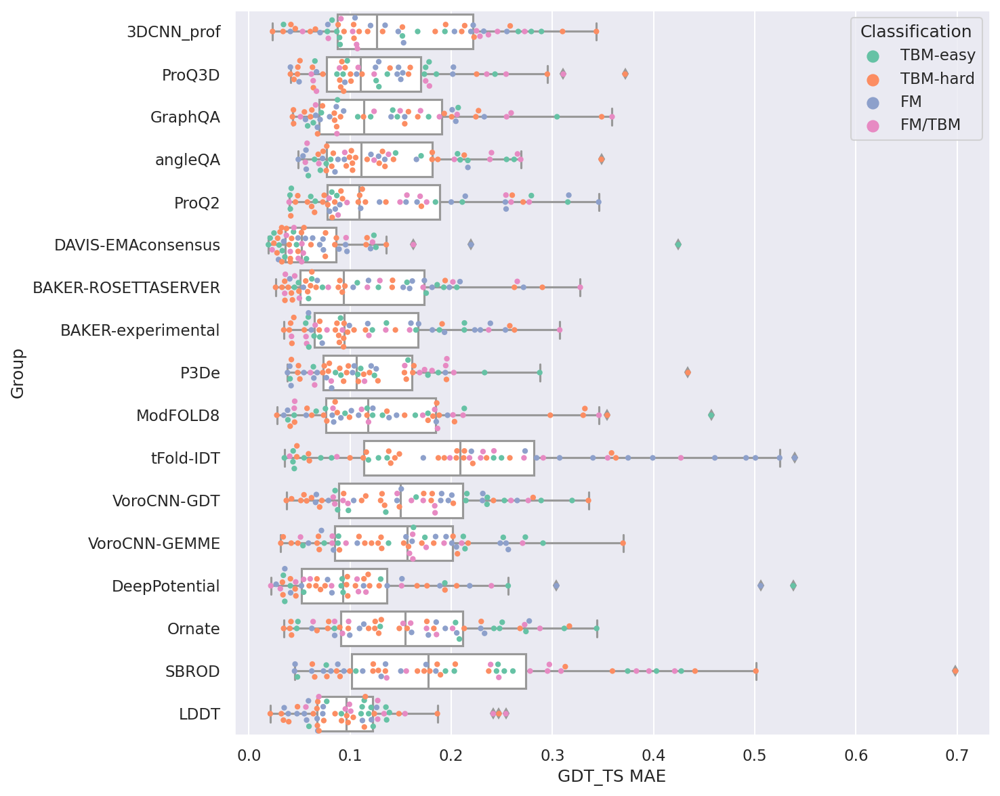

In [21]:
metrics = 'GDT_TS MAE'
hue = 'Classification'
plot_metrics_group(ceval_df, metrics, hue)
plt.savefig('../download/data/plot/casp14_gdtts_mae_boxplot_class.png')

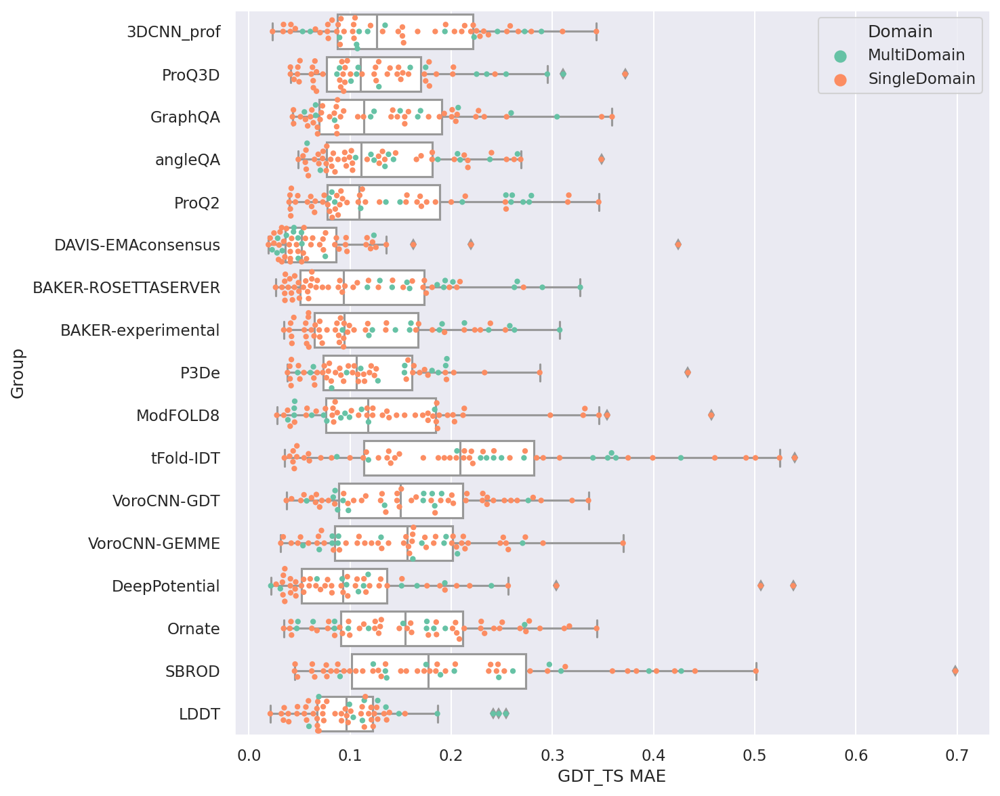

In [22]:
metrics = 'GDT_TS MAE'
hue = 'Domain'
plot_metrics_group(ceval_df, metrics, hue)
plt.savefig('../download/data/plot/casp14_mae_pearson_boxplot_domain.png')

In [23]:
for name, group in ceval_df.groupby('Classification'):
    print(name)
    display(group.groupby('Group').mean().drop(['Residues', 'Residues in domain'], axis=1))

FM


,GDT_TS Pearson,GDT_TS Spearman,GDT_TS Loss,GDT_TS MAE,GDT_TS MSE
Group,,,,,
3DCNN_prof,0.491,0.483,20.548,0.152,0.036
BAKER-ROSETTASERVER,0.528,0.479,13.991,0.145,0.031
BAKER-experimental,0.563,0.531,16.098,0.158,0.036
DAVIS-EMAconsensus,0.633,0.656,17.299,0.082,0.012
DeepPotential,0.746,0.694,8.778,0.149,0.045
GraphQA,0.419,0.442,16.655,0.121,0.026
LDDT,0.845,0.823,0.589,0.072,0.008
ModFOLD8,0.536,0.551,14.398,0.107,0.018
Ornate,0.492,0.466,23.449,0.164,0.037


FM/TBM


,GDT_TS Pearson,GDT_TS Spearman,GDT_TS Loss,GDT_TS MAE,GDT_TS MSE
Group,,,,,
3DCNN_prof,0.708,0.658,9.331,0.159,0.038
BAKER-ROSETTASERVER,0.770,0.722,6.506,0.133,0.031
BAKER-experimental,0.750,0.729,5.945,0.123,0.027
DAVIS-EMAconsensus,0.852,0.719,7.739,0.067,0.009
DeepPotential,0.689,0.551,11.829,0.092,0.015
GraphQA,0.586,0.549,13.106,0.174,0.045
LDDT,0.834,0.844,3.098,0.133,0.024
ModFOLD8,0.686,0.634,9.586,0.155,0.036
Ornate,0.663,0.656,12.982,0.161,0.035


TBM-easy


,GDT_TS Pearson,GDT_TS Spearman,GDT_TS Loss,GDT_TS MAE,GDT_TS MSE
Group,,,,,
3DCNN_prof,0.505,0.459,4.925,0.151,0.034
BAKER-ROSETTASERVER,0.591,0.544,6.941,0.120,0.021
BAKER-experimental,0.517,0.478,4.339,0.120,0.023
DAVIS-EMAconsensus,0.779,0.737,3.964,0.082,0.020
DeepPotential,0.255,0.187,16.075,0.142,0.045
GraphQA,0.450,0.392,3.997,0.135,0.028
LDDT,0.646,0.684,3.761,0.111,0.016
ModFOLD8,0.702,0.654,4.430,0.142,0.034
Ornate,0.439,0.375,4.938,0.199,0.052


TBM-hard


,GDT_TS Pearson,GDT_TS Spearman,GDT_TS Loss,GDT_TS MAE,GDT_TS MSE
Group,,,,,
3DCNN_prof,0.658,0.611,8.134,0.141,0.032
BAKER-ROSETTASERVER,0.727,0.676,6.661,0.091,0.016
BAKER-experimental,0.653,0.615,7.236,0.100,0.018
DAVIS-EMAconsensus,0.788,0.684,7.745,0.058,0.006
DeepPotential,0.615,0.510,11.560,0.098,0.015
GraphQA,0.583,0.517,7.232,0.123,0.026
LDDT,0.787,0.786,1.643,0.091,0.013
ModFOLD8,0.668,0.588,6.682,0.151,0.036
Ornate,0.588,0.550,9.217,0.131,0.026


### correlation between each group

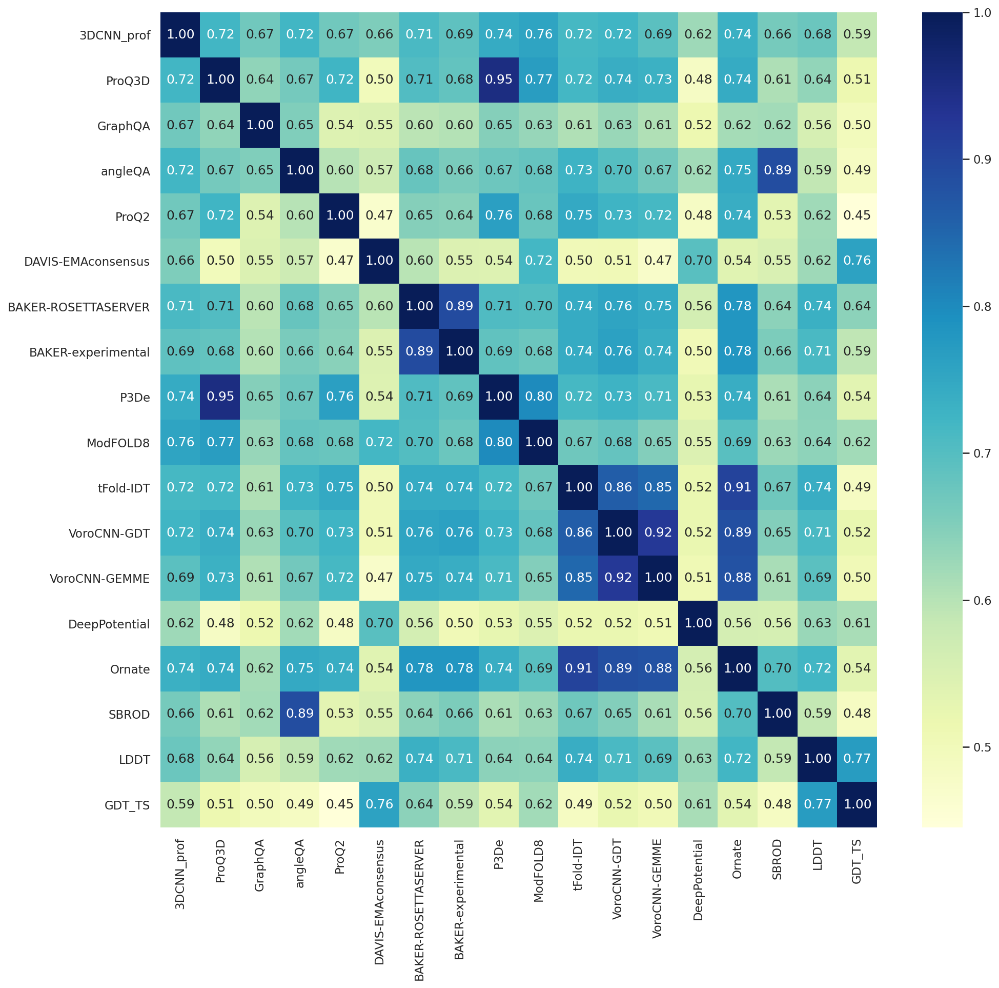

In [24]:
plt.figure(figsize=(14, 13))
sns.heatmap(df[single_model_list + ['GDT_TS', 'Target']].groupby('Target').corr().mean(level=1), cmap='YlGnBu', annot=True, fmt='.2f')
plt.tight_layout()
plt.savefig('../download/data/plot/casp14_mean_correlation_group.png')

# analyze 3DCNN_prof

In [25]:
df.groupby('Target').groups.keys()

dict_keys(['T1024', 'T1025', 'T1026', 'T1027', 'T1028', 'T1029', 'T1030', 'T1031', 'T1032', 'T1033', 'T1034', 'T1035', 'T1036s1', 'T1037', 'T1038', 'T1039', 'T1040', 'T1041', 'T1042', 'T1043', 'T1045s1', 'T1045s2', 'T1046s1', 'T1046s2', 'T1047s1', 'T1047s2', 'T1048', 'T1049', 'T1050', 'T1052', 'T1053', 'T1054', 'T1055', 'T1056', 'T1057', 'T1058', 'T1060s2', 'T1060s3', 'T1061', 'T1062', 'T1064', 'T1065s1', 'T1065s2', 'T1067', 'T1068', 'T1070', 'T1072s1', 'T1073', 'T1074', 'T1076', 'T1078', 'T1079', 'T1080', 'T1082', 'T1083', 'T1084', 'T1085', 'T1086', 'T1087', 'T1088', 'T1089', 'T1090', 'T1091', 'T1092', 'T1093', 'T1094', 'T1095', 'T1096', 'T1098', 'T1099', 'T1100', 'T1101'])

In [26]:
df.query('Target == "T1098"').sort_index()['GDT_TS']

T1098TS013_1   44.279
T1098TS013_2   44.108
T1098TS013_3   44.165
T1098TS013_4   44.508
T1098TS013_5   45.595
                ...  
T1098TS487_1   48.913
T1098TS487_2   48.455
T1098TS487_3   48.741
T1098TS487_4   49.199
T1098TS487_5   49.542
Name: GDT_TS, Length: 150, dtype: float64

In [27]:
ceval_df.query('Group=="3DCNN_prof"').sort_values('GDT_TS Pearson', ascending=True)

,Target,Group,GDT_TS Pearson,GDT_TS Spearman,GDT_TS Loss,GDT_TS MAE,GDT_TS MSE,Residues,Type,Domains,Residues in domain,Classification,PDB,Domain
102,T1031,3DCNN_prof,-0.244,-0.186,45.527,0.203,0.063,95,All groups,T1031-D1: 1-95,95,FM,6vr4,SingleDomain
884,T1092,3DCNN_prof,-0.108,-0.159,38.029,0.109,0.016,426,All groups,T1092-D0,426,TBM-hard,-,MultiDomain
136,T1033,3DCNN_prof,-0.031,0.048,13.250,0.105,0.015,100,All groups,T1033-D1: 1-100,100,FM,6vr4,SingleDomain
289,T1043,3DCNN_prof,0.002,0.270,26.520,0.070,0.010,148,All groups,T1043-D1: 1-148,148,FM,6vr4,SingleDomain
918,T1095,3DCNN_prof,0.230,0.228,3.858,0.094,0.011,665,All groups,T1095-D1: 1-649,649,TBM-hard,-,SingleDomain
170,T1035,3DCNN_prof,0.232,0.203,34.804,0.228,0.077,102,All groups,T1035-D1: 1-102,102,FM/TBM,6vr4,SingleDomain
850,T1089,3DCNN_prof,0.248,0.294,7.825,0.078,0.008,404,All groups,T1089-D1: 28-404,377,TBM-easy,-,SingleDomain
833,T1087,3DCNN_prof,0.261,0.452,0.807,0.104,0.018,186,All groups,T1087-D1: 1-93,93,TBM-hard,-,SingleDomain
221,T1039,3DCNN_prof,0.261,0.385,29.658,0.120,0.019,161,All groups,T1039-D1: 1-161,161,FM,6vr4,SingleDomain
238,T1040,3DCNN_prof,0.336,0.348,22.885,0.078,0.009,130,All groups,T1040-D1: 1-130,130,FM,6vr4,SingleDomain


In [28]:
# compared to LDDT
ceval_df.query('Group=="LDDT"')#.sort_values('GDT_TS Pearson', ascending=True)

,Target,Group,GDT_TS Pearson,GDT_TS Spearman,GDT_TS Loss,GDT_TS MAE,GDT_TS MSE,Residues,Type,Domains,Residues in domain,Classification,PDB,Domain
16,T1024,LDDT,0.804,0.781,4.412,0.059,0.004,408,All groups,T1024-D0,408,TBM-easy,6t1z,MultiDomain
33,T1025,LDDT,0.711,0.871,2.238,0.111,0.015,268,Server only,T1025-D1: 12-268,257,TBM-easy,6uv6,SingleDomain
50,T1026,LDDT,0.933,0.925,0.000,0.067,0.006,172,All groups,T1026-D1: 27-172,146,TBM-hard,6s44,SingleDomain
67,T1028,LDDT,0.677,0.821,0.343,0.112,0.015,316,Server only,T1028-D1: 16-307,292,TBM-easy,-,SingleDomain
84,T1029,LDDT,0.744,0.705,3.000,0.055,0.004,125,All groups,T1029-D1: 1-125,125,FM,6uf2,SingleDomain
101,T1030,LDDT,0.867,0.856,0.000,0.186,0.037,273,All groups,T1030-D0: 1-273,273,TBM-hard,6poo,MultiDomain
118,T1031,LDDT,0.810,0.809,0.000,0.059,0.006,95,All groups,T1031-D1: 1-95,95,FM,6vr4,SingleDomain
135,T1032,LDDT,0.799,0.792,0.000,0.021,0.001,284,All groups,T1032-D1: 100-269,170,TBM-hard,6n64,SingleDomain
152,T1033,LDDT,0.745,0.697,0.000,0.068,0.005,100,All groups,T1033-D1: 1-100,100,FM,6vr4,SingleDomain
169,T1034,LDDT,0.605,0.793,0.481,0.136,0.023,156,All groups,T1034-D1: 1-156,156,TBM-easy,-,SingleDomain


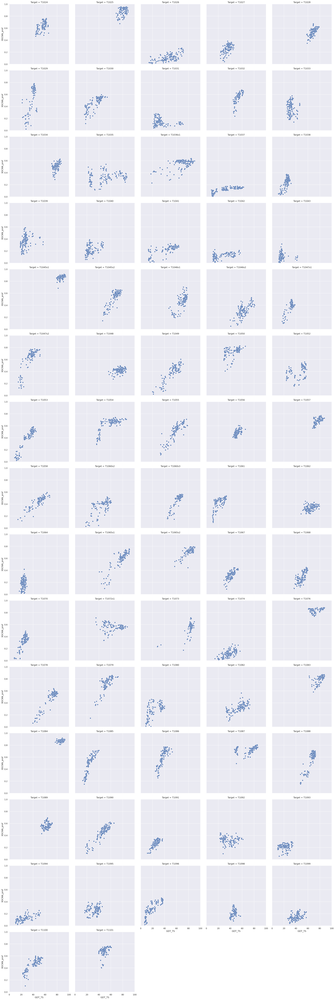

In [29]:
scatter(df, x='GDT_TS', y='3DCNN_prof', col_wrap=5)
plt.savefig('../download/data/plot/casp14_gdtts_3dcnnprof_scatter.png')

In [30]:
df

,3DCNN_prof,ProQ3D,GraphQA,angleQA,ProQ2,DAVIS-EMAconsensus,BAKER-ROSETTASERVER,BAKER-experimental,P3De,ModFOLD8,...,MolPrb_ramfv,N1,N2,DIST,N,RMSD,GDT_TS,LGA_S3,LGA_Q,Target
T1024TS075_1,0.661,0.586,0.649,0.467,0.598,0.648,0.678,0.618,0.568,0.582,...,95.320,408.000,391.000,4.000,203.000,2.480,47.059,45.012,7.868,T1024
T1024TS050_4,0.570,0.541,0.579,0.416,0.547,0.624,0.601,0.542,0.532,0.571,...,93.100,408.000,391.000,4.000,224.000,2.690,50.256,48.095,8.024,T1024
T1024TS211_4,0.560,0.532,0.584,0.419,0.541,0.611,0.625,0.592,0.492,0.536,...,84.680,374.000,391.000,4.000,199.000,2.320,46.036,46.466,8.220,T1024
T1024TS367_5,0.698,0.684,0.646,0.601,0.610,0.690,0.743,0.731,0.614,0.579,...,96.800,408.000,391.000,4.000,328.000,2.330,60.934,62.641,13.478,T1024
T1024TS278_1,0.697,0.751,0.716,0.487,0.738,0.683,0.727,0.668,0.703,0.557,...,97.540,408.000,391.000,4.000,289.000,2.260,59.910,55.603,12.245,T1024
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
T1101TS013_5,0.677,0.653,0.719,0.708,0.791,0.518,0.739,0.762,0.625,0.528,...,94.300,318.000,297.000,4.000,172.000,1.940,47.138,43.689,8.418,T1101
T1101TS031_4,0.711,0.603,0.668,0.693,0.666,0.559,0.679,0.661,0.594,0.537,...,90.190,318.000,297.000,4.000,188.000,1.880,51.010,48.073,9.512,T1101
T1101TS140_5,0.690,0.624,0.704,0.762,0.676,0.574,0.701,0.731,0.590,0.563,...,91.140,318.000,297.000,4.000,200.000,2.560,57.239,50.569,7.505,T1101
T1101TS435_4,0.669,0.533,0.666,0.692,0.691,0.546,0.629,0.604,0.549,0.507,...,79.430,318.000,297.000,4.000,168.000,2.400,49.579,43.283,6.709,T1101


In [31]:
stack_df = df.stack().reset_index(level=1).rename({'level_1': 'Method', 0: 'Score'}, axis=1)
stack_df

,Method,Score
T1024TS075_1,3DCNN_prof,0.661
T1024TS075_1,ProQ3D,0.586
T1024TS075_1,GraphQA,0.649
T1024TS075_1,angleQA,0.467
T1024TS075_1,ProQ2,0.598
...,...,...
T1101TS337_4,RMSD,2.070
T1101TS337_4,GDT_TS,52.946
T1101TS337_4,LGA_S3,45.451
T1101TS337_4,LGA_Q,8.419


In [32]:
convert_df = pd.merge(stack_df, df[['GDT_TS', 'Target']], left_index=True, right_index=True, how='inner')
convert_df

,Method,Score,GDT_TS,Target
T1024TS013_1,3DCNN_prof,0.719,57.545,T1024
T1024TS013_1,ProQ3D,0.720,57.545,T1024
T1024TS013_1,GraphQA,0.678,57.545,T1024
T1024TS013_1,angleQA,0.501,57.545,T1024
T1024TS013_1,ProQ2,0.745,57.545,T1024
...,...,...,...,...
T1101TS487_5,RMSD,1.870,55.387,T1101
T1101TS487_5,GDT_TS,55.387,55.387,T1101
T1101TS487_5,LGA_S3,51.160,55.387,T1101
T1101TS487_5,LGA_Q,9.790,55.387,T1101


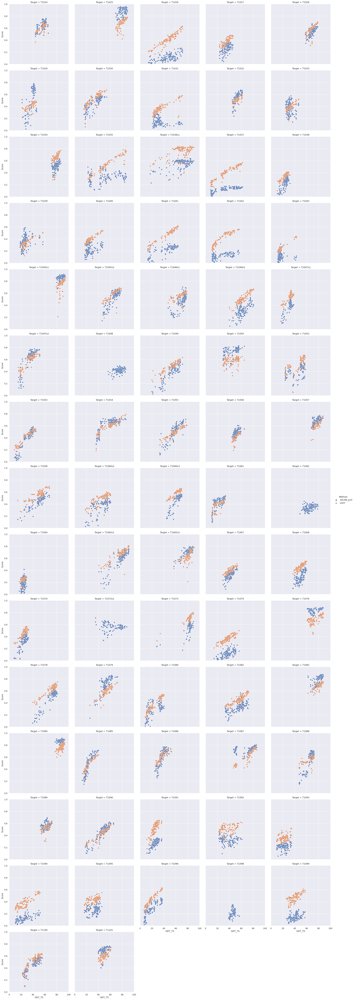

In [33]:
x = 'GDT_TS'
y = 'Score'
compare_method_list = ['3DCNN_prof', 'LDDT']
g = sns.relplot(data=convert_df.query('Method in @compare_method_list'), kind='scatter', x=x, y=y, hue='Method', col='Target', col_wrap=5)
g.set(xlim=(0, 100), ylim=(0, 1))
plt.subplots_adjust(wspace=0.1)
plt.savefig('../download/data/plot/casp14_gdtts_3dcnnprof_lddt_scatter.png')

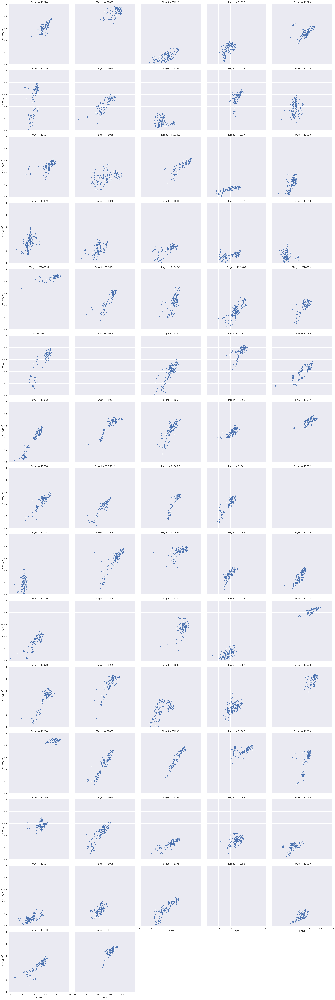

In [34]:
x = 'LDDT'
y = '3DCNN_prof'
g = sns.relplot(data=df, kind='scatter', x=x, y=y, col='Target', col_wrap=5)
g.set(xlim=(0, 1), ylim=(0, 1))
plt.subplots_adjust(wspace=0.1)
# plt.savefig('../download/data/plot/casp14_lddt_3dcnnprof_scatter.png')

In [35]:
eval(df, columns=single_model_list, label_name='LDDT').groupby('Group').mean()

68


,LDDT Pearson,LDDT Spearman,LDDT Loss,LDDT MAE,LDDT MSE
Group,,,,,
3DCNN_prof,0.677,0.643,7.529,0.130,0.025
BAKER-ROSETTASERVER,0.735,0.716,4.060,0.079,0.010
BAKER-experimental,0.713,0.698,4.881,0.086,0.012
DAVIS-EMAconsensus,0.624,0.575,7.147,0.120,0.022
DeepPotential,0.629,0.544,8.433,0.155,0.038
GraphQA,0.556,0.524,8.556,0.111,0.020
LDDT,1.000,1.000,0.000,0.000,0.000
ModFOLD8,0.639,0.575,7.015,0.126,0.025
Ornate,0.722,0.677,6.059,0.100,0.015
